                      ApplicationName Clean User Name Clean PC Name   SBU  \
0  microsoft sql server native client       USR071303      PC075575   CSM   
1  microsoft sql server native client       USR044665      PC056563   AIS   
2  microsoft sql server native client       USR093451      PC090335   AIS   
3  microsoft sql server native client       USR059830      PC127891  SETS   
4  microsoft sql server native client       USR072726      PC056957   E_S   

    SBG           user.hwSBXDescription       SBE  \
0  AERO              Commercial Pricing    CEPRCP   
1   ESS        SA - Specialty Additives    AIS_SA   
2   ESS     HSM - Hon Semiconductor Mat   AIS_HSM   
3    IA                    HTHS HPS ISC  IS3_HTHS   
4  AERO  ESE Integrated Flight Deck Sys    ESEIFS   

          organizationalPerson.department CO-3Char  \
0        Prague Commercial Pr - 332032931      EUR   
1                   Converting - 10601091      USA   
2               T/FSales-Metal - 40056200      ASP   
3 

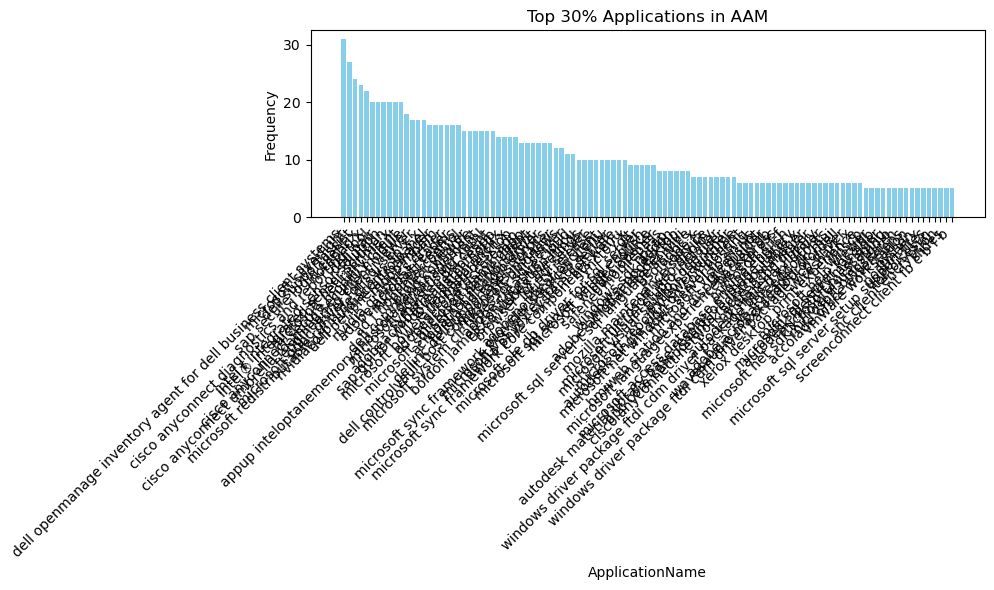

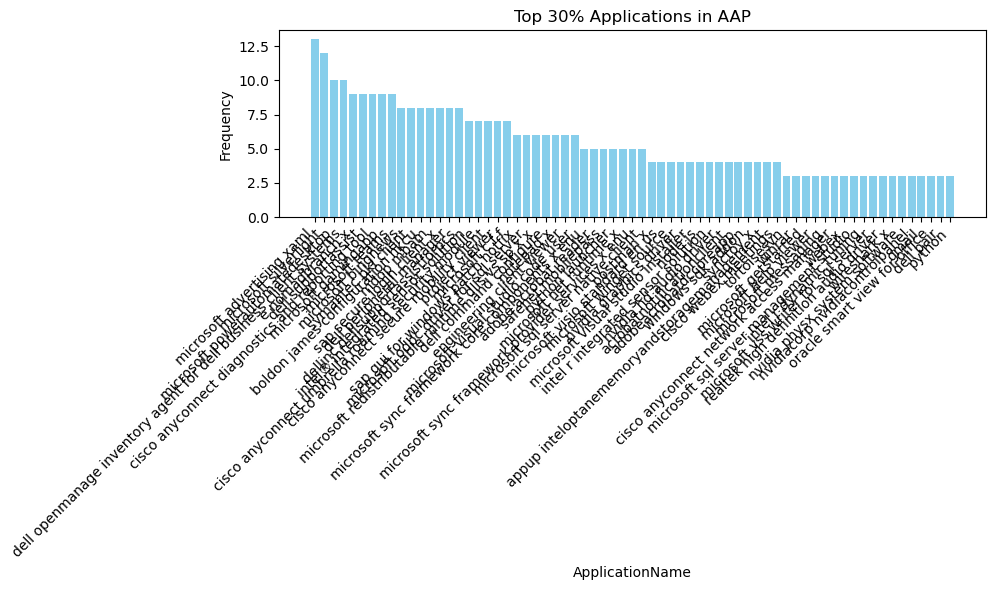

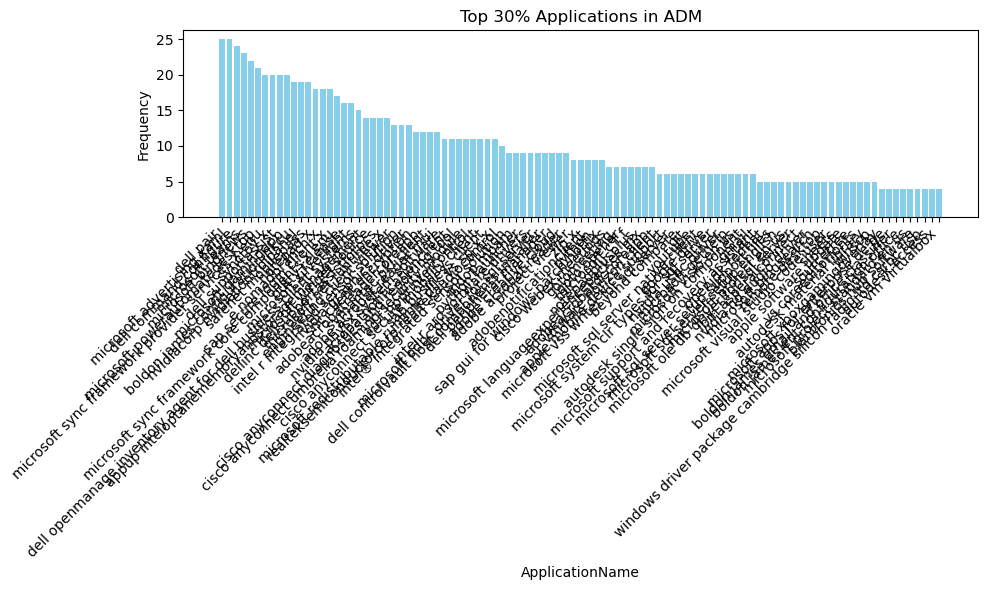

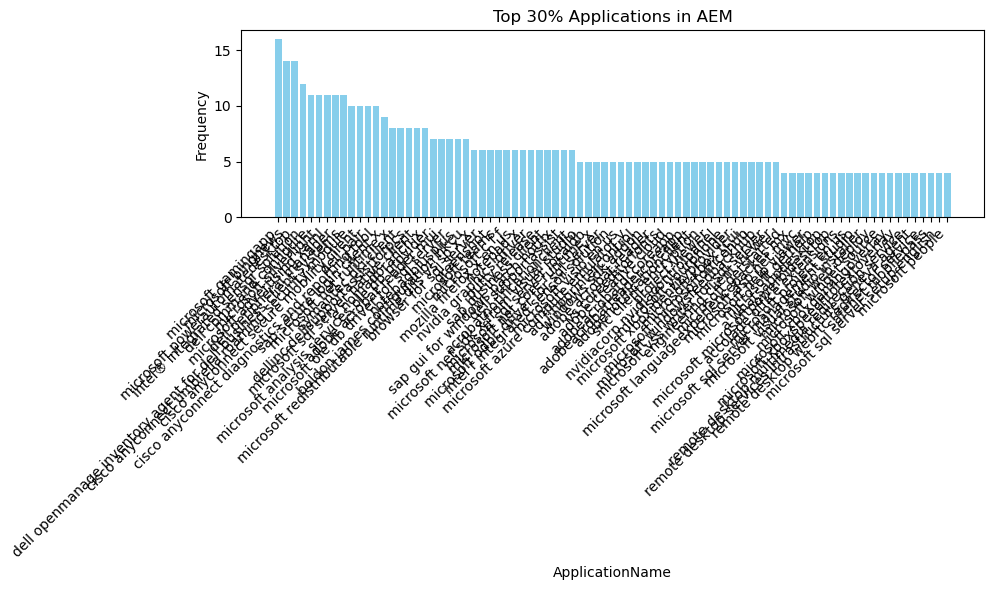

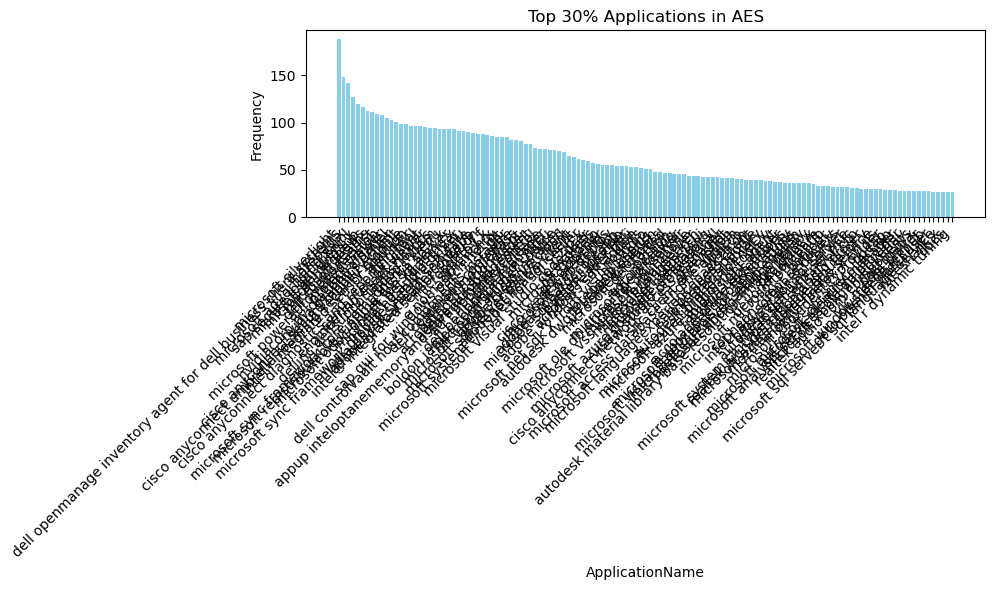

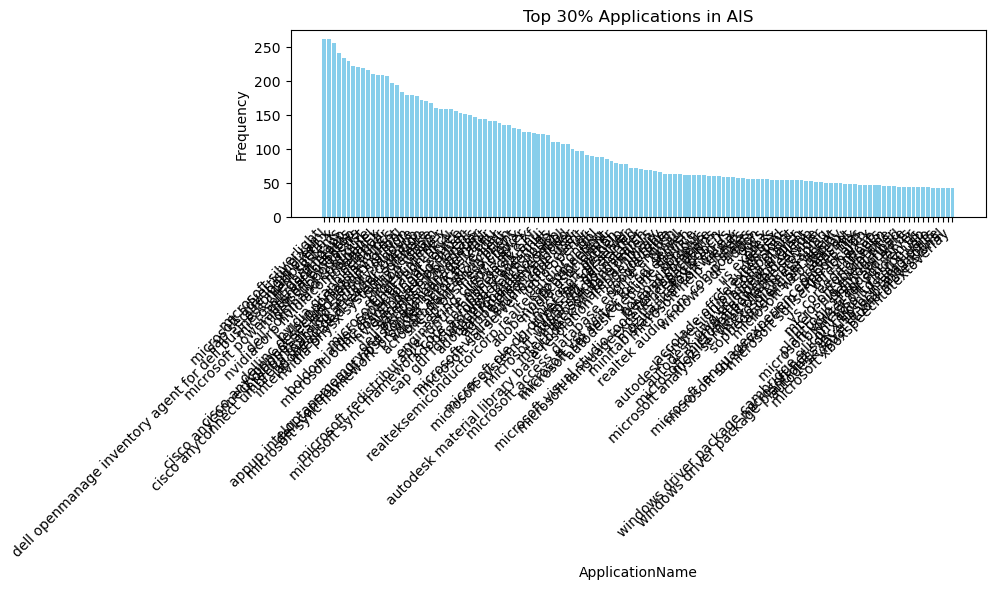

C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 20225 (\N{CJK UNIFIED IDEOGRAPH-4F01}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 19994 (\N{CJK UNIFIED IDEOGRAPH-4E1A}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 24212 (\N{CJK UNIFIED IDEOGRAPH-5E94}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 29992 (\N{CJK UNIFIED IDEOGRAPH-7528}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 29256 (\N{CJK UNIFIED IDEOGRAPH-7248}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 20225 (\N{CJK UNIFIED IDEOGRAPH-4F01

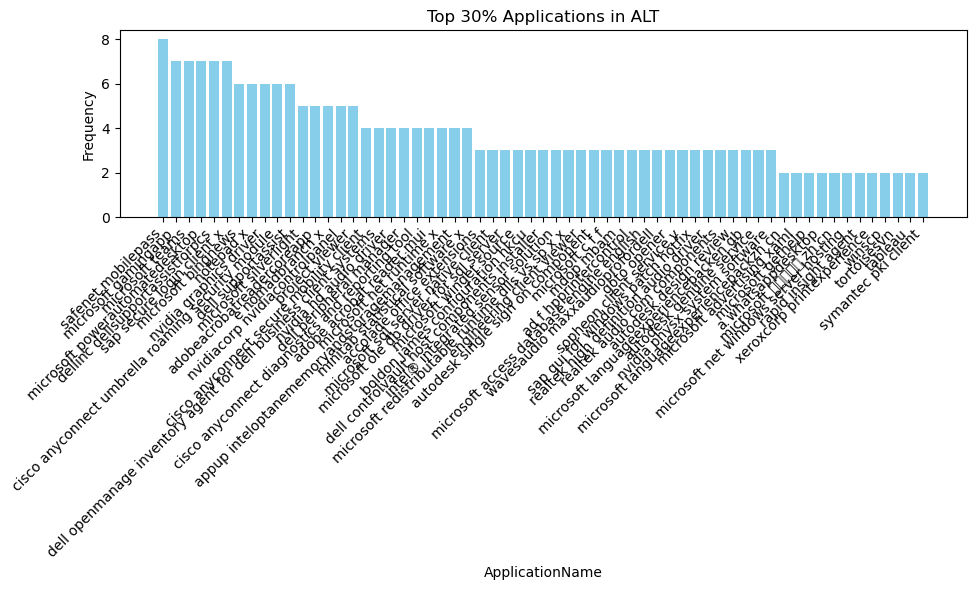

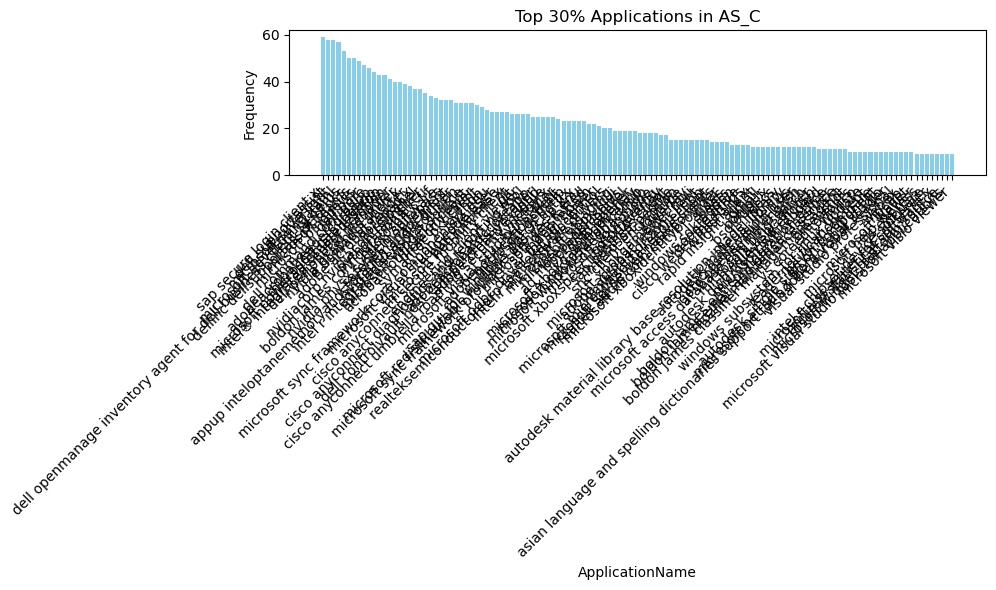

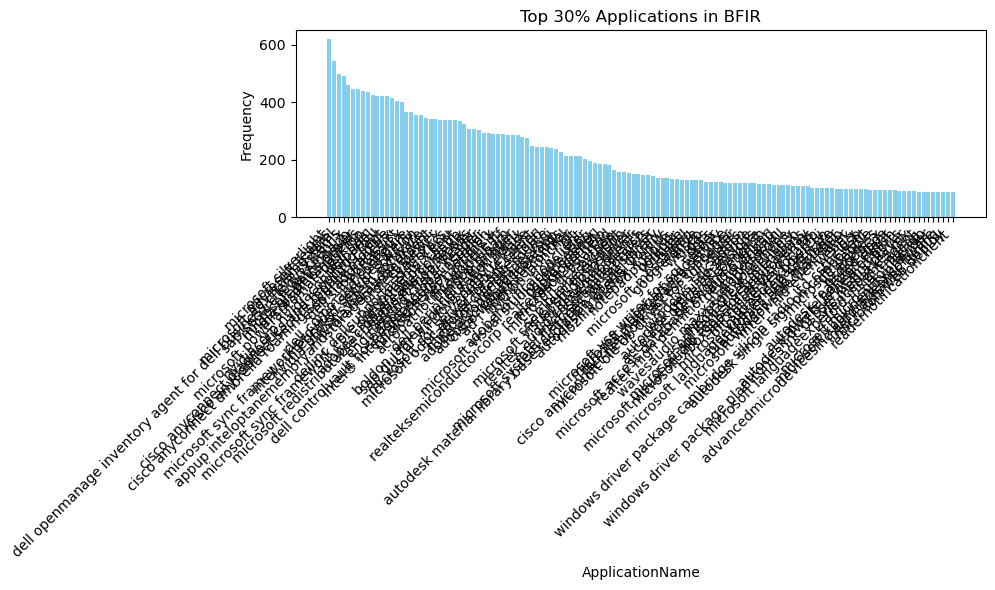

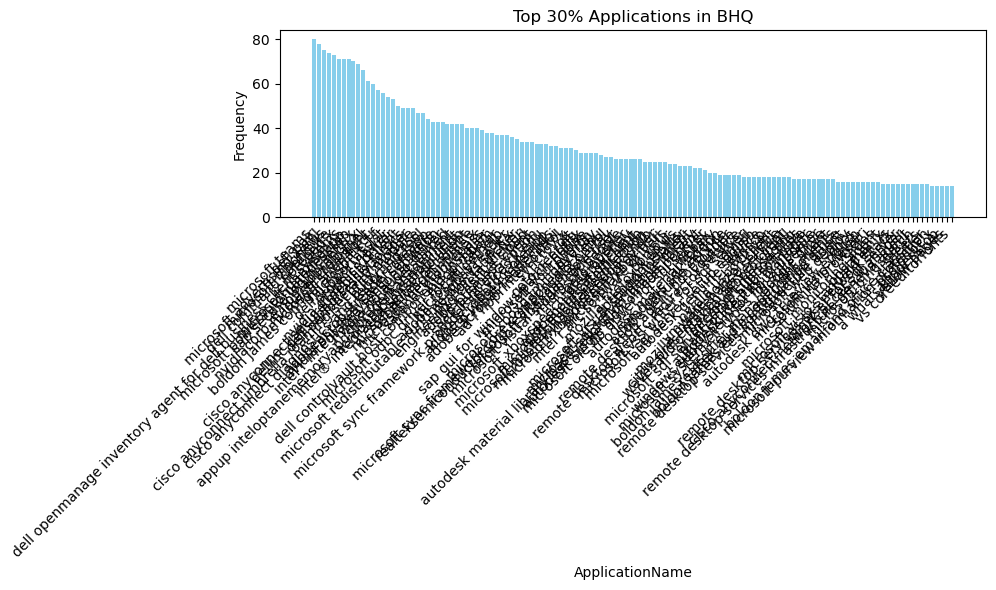

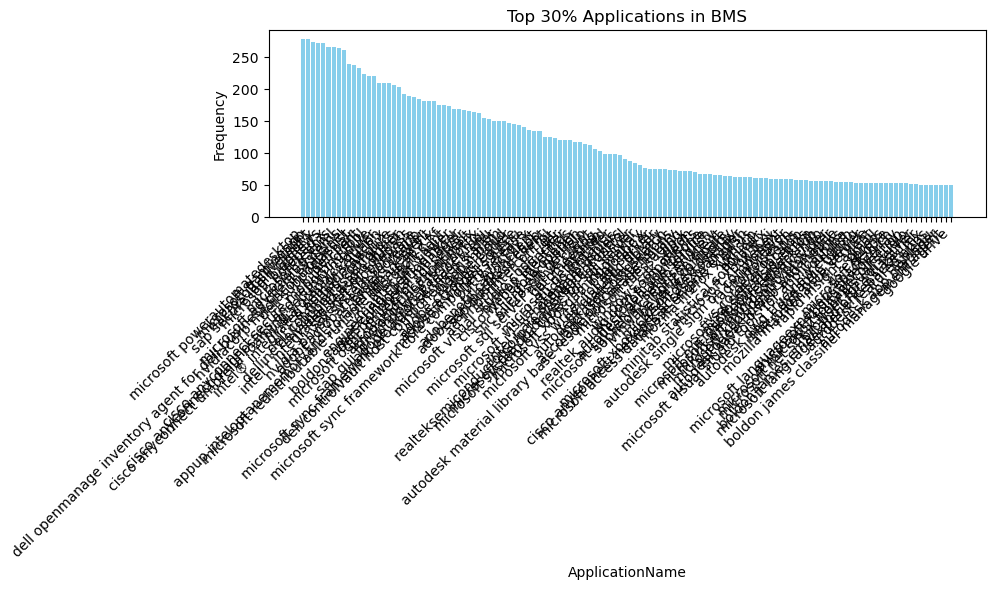

C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 32593 (\N{CJK UNIFIED IDEOGRAPH-7F51}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 26131 (\N{CJK UNIFIED IDEOGRAPH-6613}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 26377 (\N{CJK UNIFIED IDEOGRAPH-6709}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 36947 (\N{CJK UNIFIED IDEOGRAPH-9053}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 32763 (\N{CJK UNIFIED IDEOGRAPH-7FFB}) missing from current font.
  plt.tight_layout()
C:\Users\Loade\AppData\Local\Temp\ipykernel_12956\2341141693.py:45: UserWarning: Glyph 35793 (\N{CJK UNIFIED IDEOGRAPH-8BD1}) miss

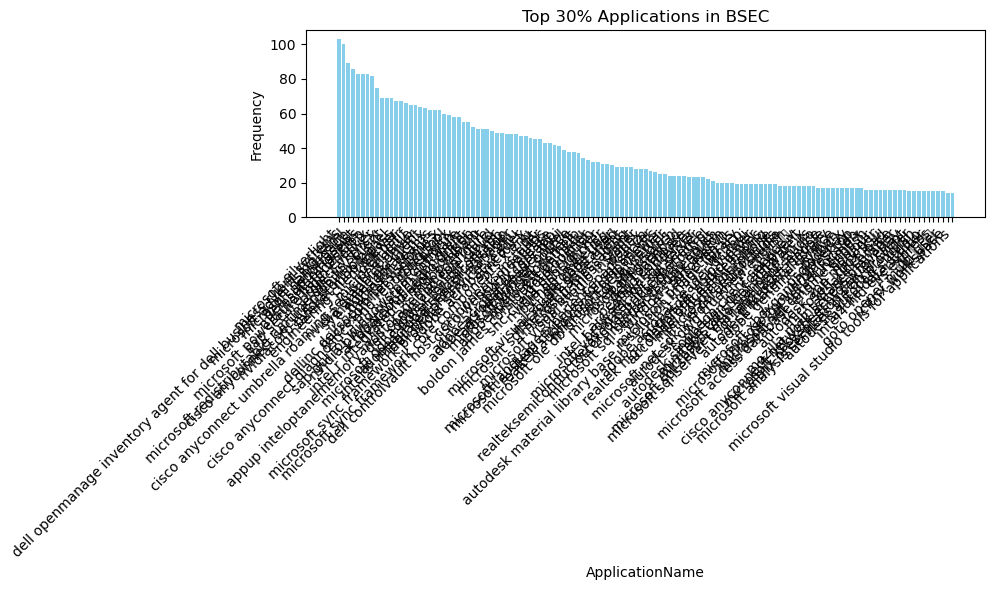

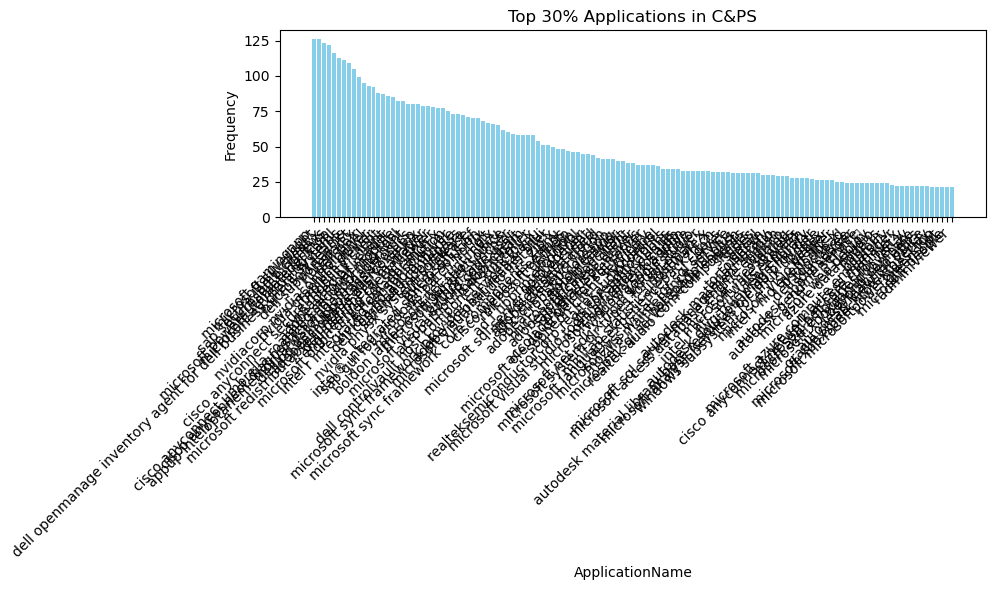

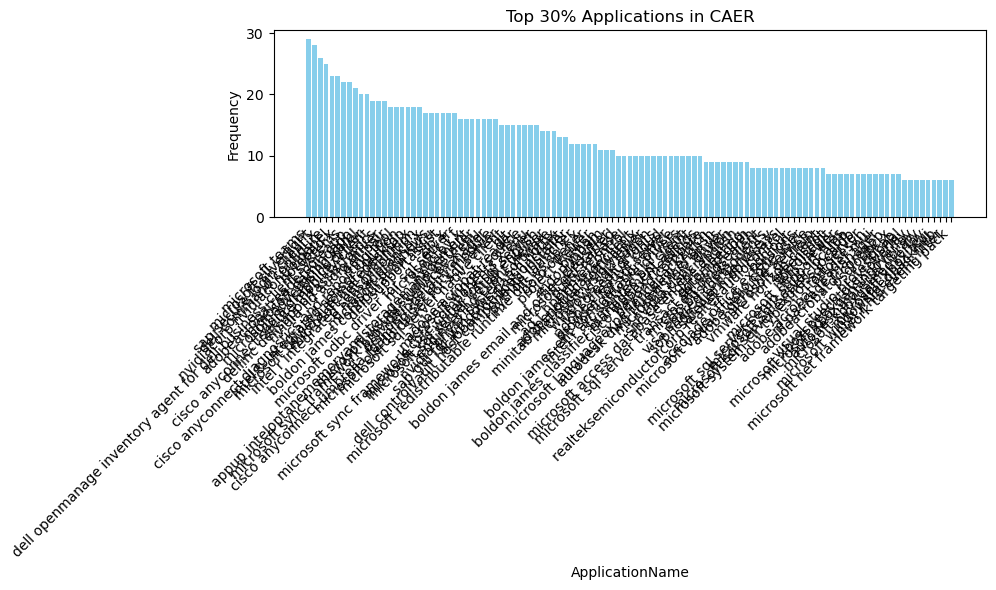

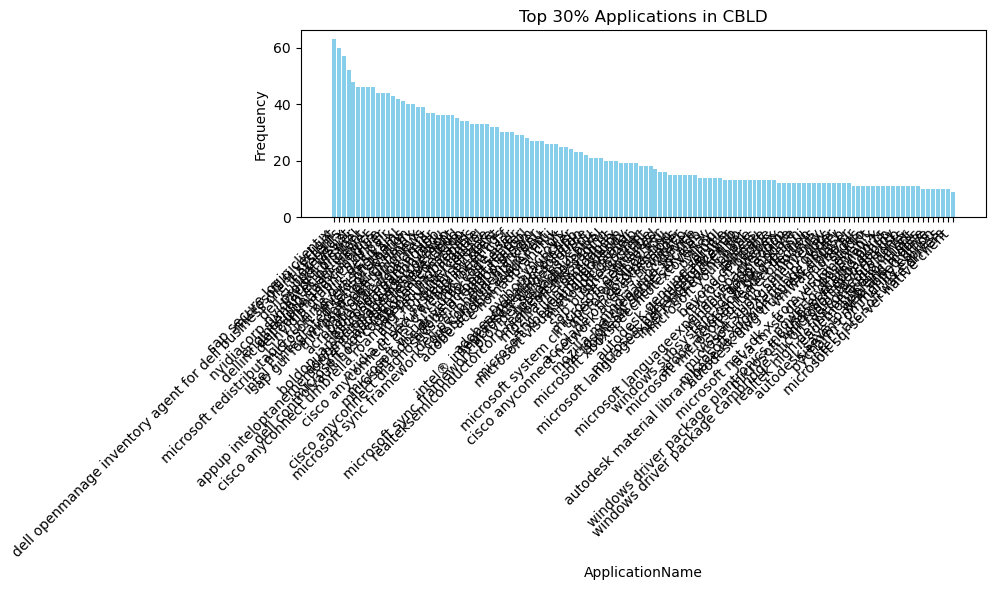

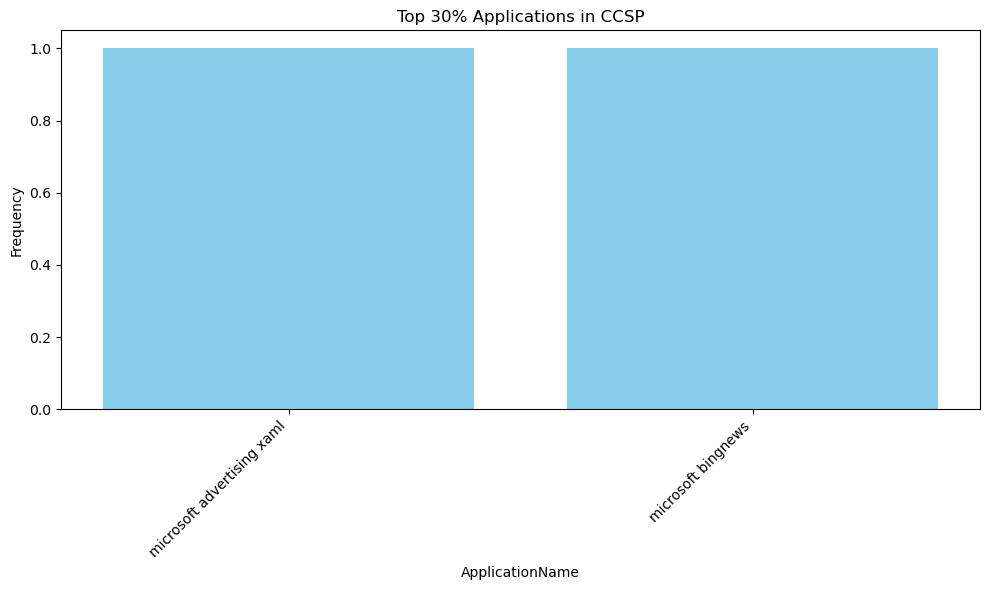

...

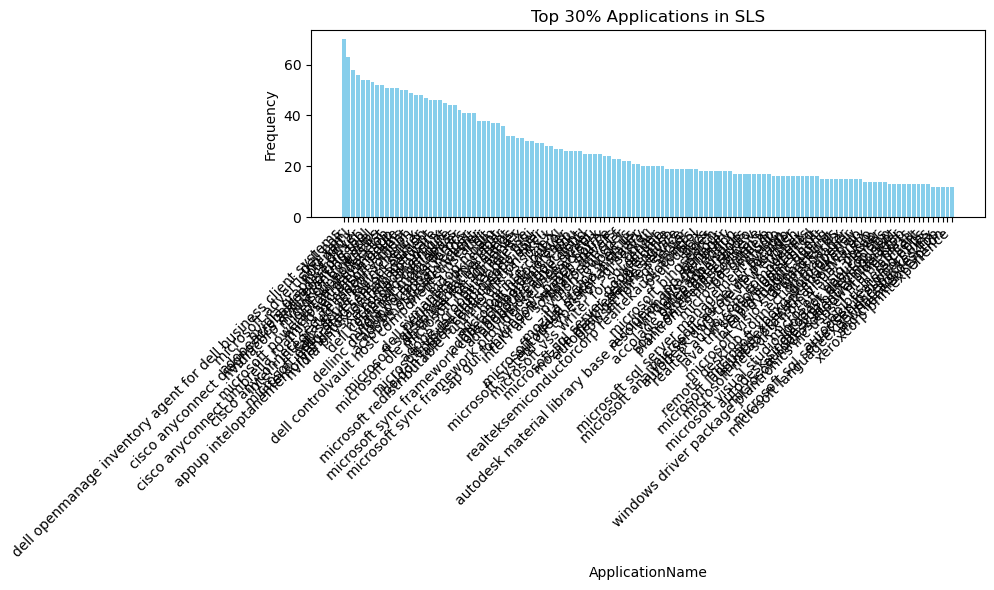

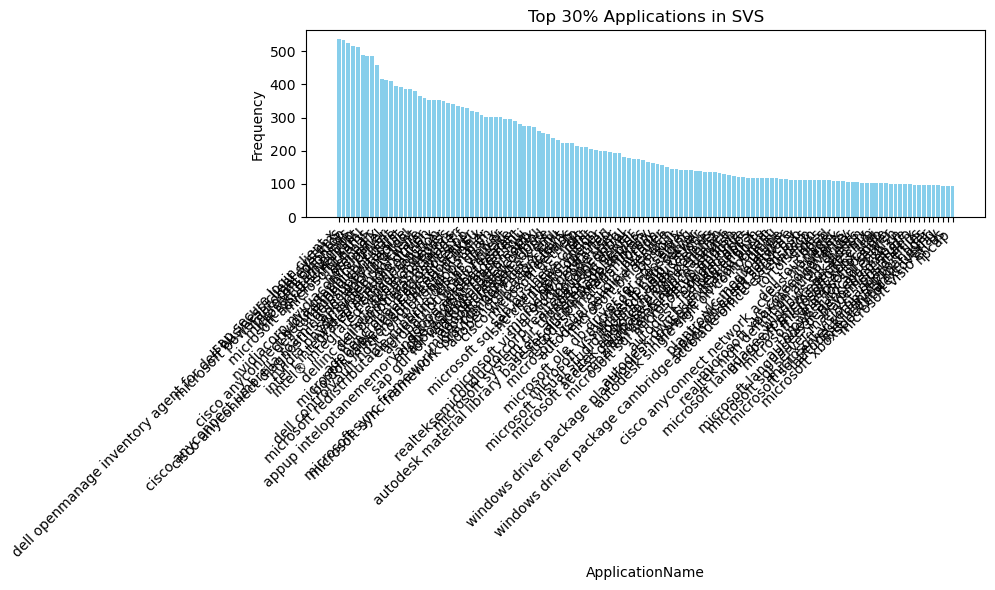

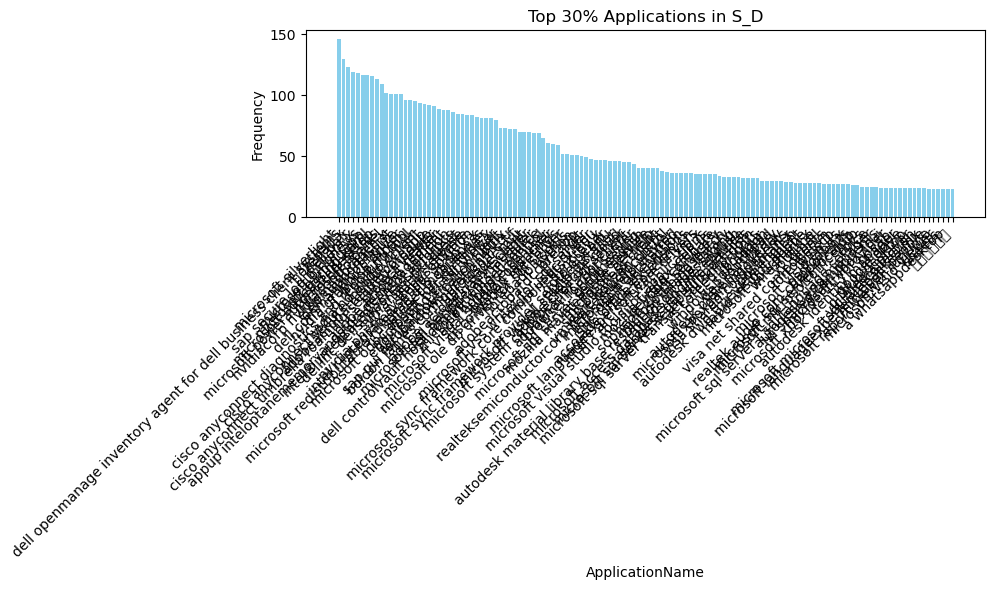

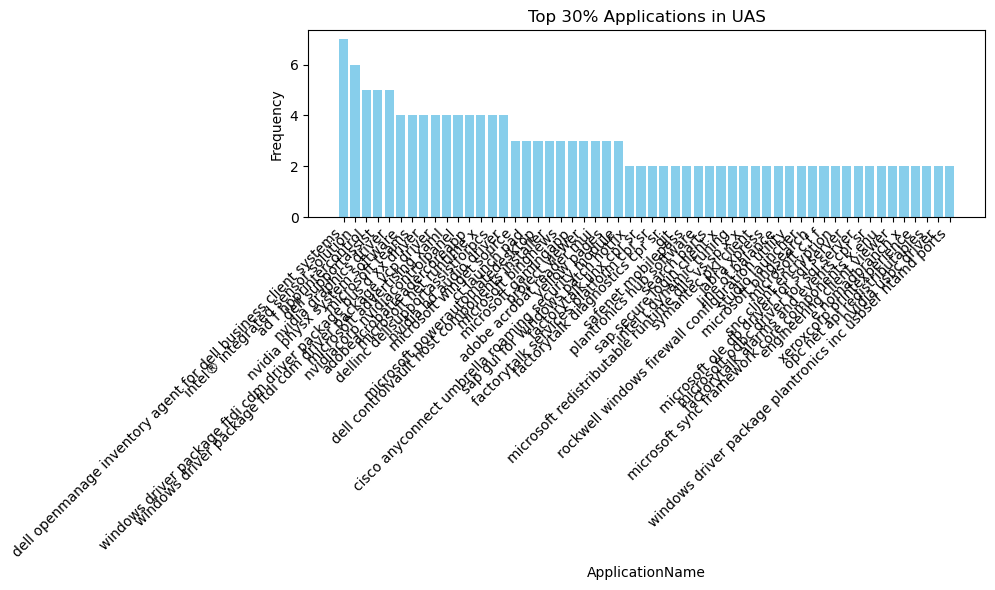

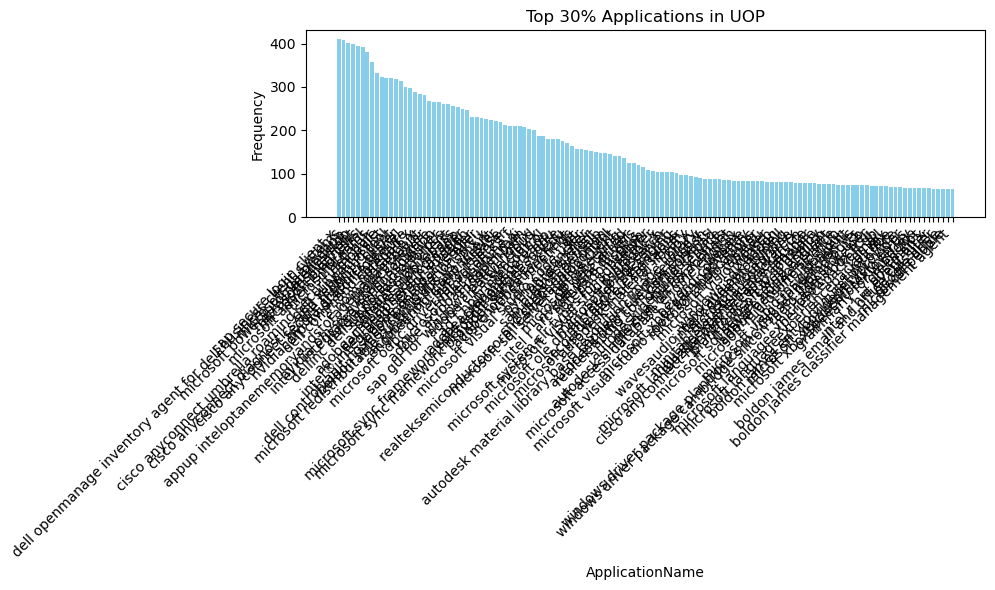

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import math

# Input and output file names
input_file = "cleaned_encoded_decoded_col.csv"
output_file = "top_30_percent_applications.csv"

# Step 1: Load the input CSV file
data = pd.read_csv(input_file)

# Preview the dataset to ensure it has required columns like 'SBU' and 'Application'
print(data.head())

# Step 2: Group by SBU and calculate application frequencies
grouped = data.groupby(['SBU', 'ApplicationName']).size().reset_index(name='Frequency')

# Step 3: Identify the top 30% applications in each SBU
top_30_percent_apps = []

for sbu, group in grouped.groupby('SBU'):
    # Sort applications by frequency
    sorted_group = group.sort_values(by='Frequency', ascending=False)
    # Calculate top 30% threshold
    top_30_threshold = math.ceil(len(sorted_group) * 0.3)
    # Select top 30% applications
    top_apps = sorted_group.head(top_30_threshold)
    top_30_percent_apps.append(top_apps)

# Combine all top applications into a single DataFrame
top_30_percent_apps_df = pd.concat(top_30_percent_apps)

# Step 4: Save the results to a new CSV file
top_30_percent_apps_df.to_csv(output_file, index=False)
print(f"Top 30% applications saved to {output_file}")

# Step 5: Visualize the data
for sbu, group in top_30_percent_apps_df.groupby('SBU'):
    plt.figure(figsize=(10, 6))
    plt.bar(group['ApplicationName'], group['Frequency'], color='skyblue')
    plt.title(f"Top 30% Applications in {sbu}")
    plt.xlabel("ApplicationName")
    plt.ylabel("Frequency")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()


In [3]:
import pandas as pd
import math
import xlsxwriter

# Input and output file names
input_file = "cleaned_encoded_decoded_col.csv"
output_file = "top_30_percent_applications_chart.xlsx"

# Step 1: Load the input CSV file
data = pd.read_csv(input_file)

# Preview the dataset to ensure it has required columns like 'SBU' and 'ApplicationName'
print(data.head())

# Step 2: Group by SBU and calculate application frequencies
grouped = data.groupby(['SBU', 'ApplicationName']).size().reset_index(name='Frequency')

# Step 3: Identify the top 30% applications in each SBU
top_30_percent_apps = []

for sbu, group in grouped.groupby('SBU'):
    # Sort applications by frequency
    sorted_group = group.sort_values(by='Frequency', ascending=False)
    # Calculate top 30% threshold
    top_30_threshold = math.ceil(len(sorted_group) * 0.3)
    # Select top 30% applications
    top_apps = sorted_group.head(top_30_threshold)
    top_30_percent_apps.append((sbu, top_apps))

# Create an Excel writer object using xlsxwriter
with pd.ExcelWriter(output_file, engine='xlsxwriter') as writer:
    # Access the workbook and add sheets
    workbook = writer.book

    # Step 4: Write each SBU's data to a separate sheet with a chart
    for sbu, group in top_30_percent_apps:
        # Write data to sheet
        group.to_excel(writer, sheet_name=sbu, index=False, startrow=0, startcol=0)

        # Add chart for visualization
        worksheet = writer.sheets[sbu]
        chart = workbook.add_chart({'type': 'column'})

        # Configure the chart
        chart.add_series({
            'categories': [sbu, 1, 1, len(group), 1],  # ApplicationName column
            'values': [sbu, 1, 2, len(group), 2],       # Frequency column
            'name': f"Top 30% Applications in {sbu}",
        })

        # Add chart title and labels
        chart.set_title({'name': f"Top 30% Applications in {sbu}"})
        chart.set_x_axis({'name': 'ApplicationName'})
        chart.set_y_axis({'name': 'Frequency'})

        # Insert chart to the right of the data
        worksheet.insert_chart('E2', chart)

# Save the workbook
print(f"Excel file with top 30% applications and charts saved to {output_file}")


                      ApplicationName Clean User Name Clean PC Name   SBU  \
0  microsoft sql server native client       USR071303      PC075575   CSM   
1  microsoft sql server native client       USR044665      PC056563   AIS   
2  microsoft sql server native client       USR093451      PC090335   AIS   
3  microsoft sql server native client       USR059830      PC127891  SETS   
4  microsoft sql server native client       USR072726      PC056957   E_S   

    SBG           user.hwSBXDescription       SBE  \
0  AERO              Commercial Pricing    CEPRCP   
1   ESS        SA - Specialty Additives    AIS_SA   
2   ESS     HSM - Hon Semiconductor Mat   AIS_HSM   
3    IA                    HTHS HPS ISC  IS3_HTHS   
4  AERO  ESE Integrated Flight Deck Sys    ESEIFS   

          organizationalPerson.department CO-3Char  \
0        Prague Commercial Pr - 332032931      EUR   
1                   Converting - 10601091      USA   
2               T/FSales-Metal - 40056200      ASP   
3 

In [ ]:
import pandas as pd

# Input and output file names
input_file = "top_30_percent_applications_chart.csv"
output_file = "output_file_cleaned.csv"

# List of names (or values) to remove
names_to_remove = [1, 2, 3, 4, 5]

# Step 1: Read the input CSV file
data = pd.read_csv(input_file)

# Preview the dataset
print("Preview of input data:")
print(data.head())

# Step 2: Remove rows where a column matches any value in names_to_remove
# Assuming we want to filter out rows in a specific column, e.g., 'Name'
# Replace 'Name' with the column you want to filter
if 'Name' in data.columns:
    cleaned_data = data[~data['Name'].isin(names_to_remove)]
else:
    print("'Name' column not found in the dataset. Specify the correct column.")
    cleaned_data = data  # No filtering applied

# Preview the cleaned dataset
print("Preview of cleaned data:")
print(cleaned_data.head())

# Step 3: Save the cleaned dataset back to CSV
cleaned_data.to_csv(output_file, index=False)

print(f"Cleaned data saved to: {output_file}")
